In [8]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np

In [3]:
df = pd.read_csv('C:/Users/savil/Documents/ForestFires/forestfires.csv')
df

,X,Y,month,day,FFMC,DMC,DC,ISI,temp,RH,wind,rain,area
0,7,5,mar,fri,86.2,26.2,94.3,5.1,8.2,51,6.7,0.0,0.00
1,7,4,oct,tue,90.6,35.4,669.1,6.7,18.0,33,0.9,0.0,0.00
2,7,4,oct,sat,90.6,43.7,686.9,6.7,14.6,33,1.3,0.0,0.00
3,8,6,mar,fri,91.7,33.3,77.5,9.0,8.3,97,4.0,0.2,0.00
4,8,6,mar,sun,89.3,51.3,102.2,9.6,11.4,99,1.8,0.0,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...
512,4,3,aug,sun,81.6,56.7,665.6,1.9,27.8,32,2.7,0.0,6.44
513,2,4,aug,sun,81.6,56.7,665.6,1.9,21.9,71,5.8,0.0,54.29
514,7,4,aug,sun,81.6,56.7,665.6,1.9,21.2,70,6.7,0.0,11.16
515,1,4,aug,sat,94.4,146.0,614.7,11.3,25.6,42,4.0,0.0,0.00


In [4]:
df.head()

,X,Y,month,day,FFMC,DMC,DC,ISI,temp,RH,wind,rain,area
0,7,5,mar,fri,86.2,26.2,94.3,5.1,8.2,51,6.7,0.0,0.0
1,7,4,oct,tue,90.6,35.4,669.1,6.7,18.0,33,0.9,0.0,0.0
2,7,4,oct,sat,90.6,43.7,686.9,6.7,14.6,33,1.3,0.0,0.0
3,8,6,mar,fri,91.7,33.3,77.5,9.0,8.3,97,4.0,0.2,0.0
4,8,6,mar,sun,89.3,51.3,102.2,9.6,11.4,99,1.8,0.0,0.0


In [5]:
df.isnull().sum()

X        0
Y        0
month    0
day      0
FFMC     0
DMC      0
DC       0
ISI      0
temp     0
RH       0
wind     0
rain     0
area     0
dtype: int64

In [7]:
df.dtypes

X          int64
Y          int64
month     object
day       object
FFMC     float64
DMC      float64
DC       float64
ISI      float64
temp     float64
RH         int64
wind     float64
rain     float64
area     float64
dtype: object

In [9]:
df.describe()

,X,Y,FFMC,DMC,DC,ISI,temp,RH,wind,rain,area
count,517.000000,517.000000,517.000000,517.000000,517.000000,517.000000,517.000000,517.000000,517.000000,517.000000,517.000000
mean,4.669246,4.299807,90.644681,110.872340,547.940039,9.021663,18.889168,44.288201,4.017602,0.021663,12.847292
std,2.313778,1.229900,5.520111,64.046482,248.066192,4.559477,5.806625,16.317469,1.791653,0.295959,63.655818
min,1.000000,2.000000,18.700000,1.100000,7.900000,0.000000,2.200000,15.000000,0.400000,0.000000,0.000000
25%,3.000000,4.000000,90.200000,68.600000,437.700000,6.500000,15.500000,33.000000,2.700000,0.000000,0.000000
50%,4.000000,4.000000,91.600000,108.300000,664.200000,8.400000,19.300000,42.000000,4.000000,0.000000,0.520000
75%,7.000000,5.000000,92.900000,142.400000,713.900000,10.800000,22.800000,53.000000,4.900000,0.000000,6.570000
max,9.000000,9.000000,96.200000,291.300000,860.600000,56.100000,33.300000,100.000000,9.400000,6.400000,1090.840000


In [10]:
corr = df.corr()

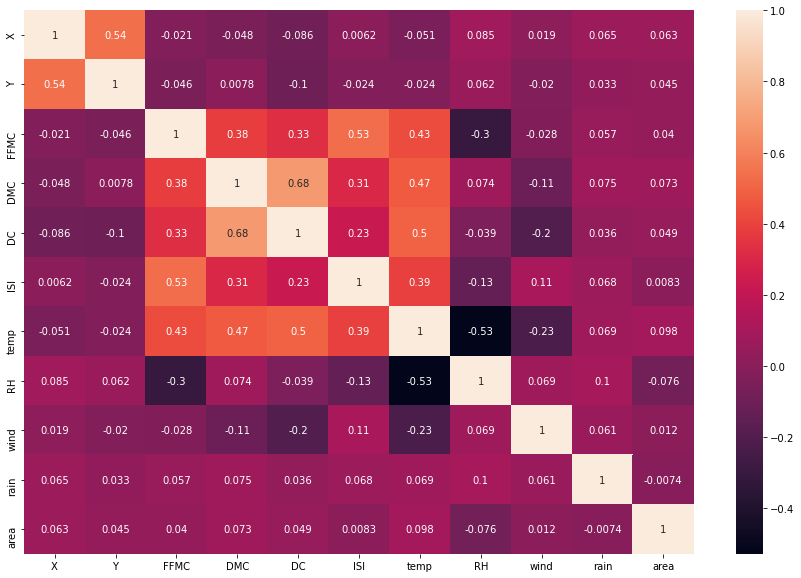

In [12]:
plt.figure(figsize = (15,10))
sns.heatmap(corr, annot = True, cbar = True)
plt.show()

In [16]:
import pandas_profiling as pp

In [17]:
dir(pp)

['Config',
 'ProfileReport',
 '__builtins__',
 '__cached__',
 '__doc__',
 '__file__',
 '__init__',
 '__loader__',
 '__name__',
 '__package__',
 '__path__',
 '__spec__',
 '__version__',
 'clear_config',
 'config',
 'controller',
 'model',
 'pandas_decorator',
 'profile_report',
 'report',
 'serialize_report',
 'utils',
 'version',
 'visualisation']

In [18]:
pp.ProfileReport(df = df)

In [19]:
# Dropping rain because it doesn't correlate with anything, plus 98.5% of it's values are 0, which tells us nothing
df['rain'].value_counts()

0.0    509
0.8      2
0.2      2
0.4      1
6.4      1
1.4      1
1.0      1
Name: rain, dtype: int64

<AxesSubplot:>

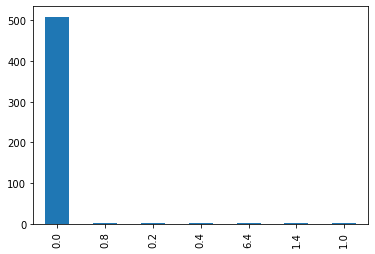

In [20]:
df['rain'].value_counts().plot(kind = 'bar')

In [21]:
df1 = df

In [22]:
df1.drop(labels = ['rain'], axis = 1, inplace = True)

In [23]:
df1.head()

,X,Y,month,day,FFMC,DMC,DC,ISI,temp,RH,wind,area
0,7,5,mar,fri,86.2,26.2,94.3,5.1,8.2,51,6.7,0.0
1,7,4,oct,tue,90.6,35.4,669.1,6.7,18.0,33,0.9,0.0
2,7,4,oct,sat,90.6,43.7,686.9,6.7,14.6,33,1.3,0.0
3,8,6,mar,fri,91.7,33.3,77.5,9.0,8.3,97,4.0,0.0
4,8,6,mar,sun,89.3,51.3,102.2,9.6,11.4,99,1.8,0.0


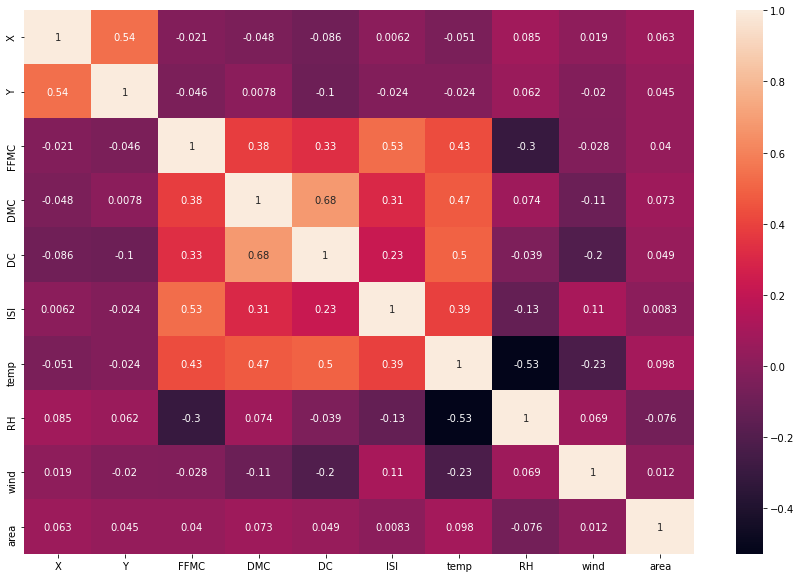

In [24]:
plt.figure(figsize = (15,10))
sns.heatmap(df1.corr(), annot = True, cbar = True)
plt.show()

In [28]:
df1['wind'].value_counts()

2.2    53
3.1    53
4.0    51
4.9    48
2.7    44
4.5    41
5.4    41
3.6    40
1.8    31
5.8    24
6.3    19
7.6    14
1.3    14
0.9    13
6.7     8
8.5     8
8.0     5
7.2     4
9.4     4
8.9     1
0.4     1
Name: wind, dtype: int64

<AxesSubplot:>

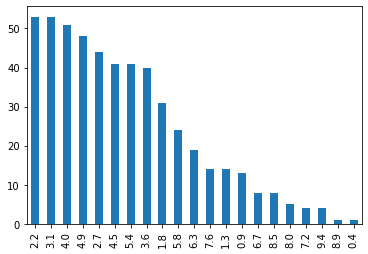

In [27]:
df1['wind'].value_counts().plot(kind = 'bar') #There is a lack of correlation with wind, but at least it has values

In [43]:
df1.columns

Index(['X', 'Y', 'month', 'day', 'FFMC', 'DMC', 'DC', 'ISI', 'temp', 'RH',
       'wind', 'area'],
      dtype='object')

<AxesSubplot:ylabel='FFMC'>

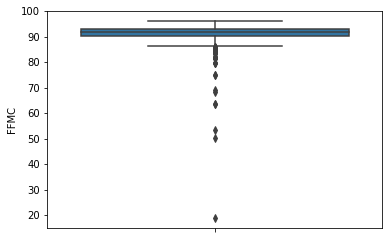

In [57]:
sns.boxplot(data = df1, y = 'FFMC')

In [63]:
df['day'].value_counts()

sun    95
fri    85
sat    84
mon    74
tue    64
thu    61
wed    54
Name: day, dtype: int64

In [64]:
day = {'mon': 1, 'tue': 2, 'wed': 3, 'thu': 4, 'fri': 5, 'sat': 6, 'sun': 7}
df1['day'] = df1['day'].map(day)

In [65]:
df.head()

,X,Y,month,day,FFMC,DMC,DC,ISI,temp,RH,wind,area
0,7,5,mar,5,86.2,26.2,94.3,5.1,8.2,51,6.7,0.0
1,7,4,oct,2,90.6,35.4,669.1,6.7,18.0,33,0.9,0.0
2,7,4,oct,6,90.6,43.7,686.9,6.7,14.6,33,1.3,0.0
3,8,6,mar,5,91.7,33.3,77.5,9.0,8.3,97,4.0,0.0
4,8,6,mar,7,89.3,51.3,102.2,9.6,11.4,99,1.8,0.0


In [66]:
df['month'].value_counts()

aug    184
sep    172
mar     54
jul     32
feb     20
jun     17
oct     15
apr      9
dec      9
may      2
jan      2
nov      1
Name: month, dtype: int64

In [67]:
month = {'jan': 1, 'feb': 2, 'mar': 3, 'apr': 4, 'may': 5, 'jun': 6, 'jul': 7, 'aug': 8, 'sep': 9, 'oct': 10, 'nov': 11, 'dec': 12}
df1['month'] = df1['month'].map(month)

In [68]:
df1.head()

,X,Y,month,day,FFMC,DMC,DC,ISI,temp,RH,wind,area
0,7,5,3,5,86.2,26.2,94.3,5.1,8.2,51,6.7,0.0
1,7,4,10,2,90.6,35.4,669.1,6.7,18.0,33,0.9,0.0
2,7,4,10,6,90.6,43.7,686.9,6.7,14.6,33,1.3,0.0
3,8,6,3,5,91.7,33.3,77.5,9.0,8.3,97,4.0,0.0
4,8,6,3,7,89.3,51.3,102.2,9.6,11.4,99,1.8,0.0


In [69]:
df1.dtypes

X          int64
Y          int64
month      int64
day        int64
FFMC     float64
DMC      float64
DC       float64
ISI      float64
temp     float64
RH         int64
wind     float64
area     float64
dtype: object

In [73]:
df1['FFMC'] = df1['FFMC'].astype(int)
df1['DMC'] = df1['DMC'].astype(int)
df1['DC'] = df1['DC'].astype(int)
df1['ISI'] = df1['ISI'].astype(int)
df1['temp'] = df1['temp'].astype(int)
df1['wind'] = df1['wind'].astype(int)
df1['area'] = df1['area'].astype(int)

In [74]:
df1.dtypes

X        int64
Y        int64
month    int64
day      int64
FFMC     int32
DMC      int32
DC       int32
ISI      int32
temp     int32
RH       int64
wind     int32
area     int32
dtype: object

<AxesSubplot:ylabel='temp'>

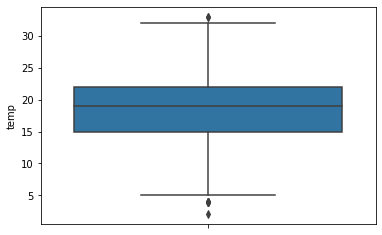

In [81]:
sns.boxplot(data = df1, y = 'temp')

### Check for outliers

In [82]:
q1 = df1.quantile(0.25)
q3 = df1.quantile(0.75)

In [83]:
IQR = q3 - q1

In [84]:
IQR

X          4.0
Y          1.0
month      2.0
day        4.0
FFMC       2.0
DMC       74.0
DC       276.0
ISI        4.0
temp       7.0
RH        20.0
wind       2.0
area       6.0
dtype: float64

In [85]:
OUTLIER = (df1 < (q1 -1.5 * IQR)) | (df1 > (q3 + 1.5 * IQR))

In [86]:
OUTLIER

,X,Y,month,day,FFMC,DMC,DC,ISI,temp,RH,wind,area
0,False,False,True,False,True,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,False,False
3,False,False,True,False,False,False,False,False,False,True,False,False
4,False,False,True,False,False,False,False,False,False,True,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...
512,False,False,False,False,True,False,False,False,False,False,False,False
513,False,False,False,False,True,False,False,False,False,False,False,True
514,False,False,False,False,True,False,False,False,False,False,False,False
515,False,False,False,False,False,False,False,False,False,False,False,False


In [87]:
NOT_OUTLIER = df1[~((df1 < (q1 - 1.5 * IQR)) | (df1 > (q3 + 1.5 * IQR))).any(axis=1)]

In [88]:
NOT_OUTLIER

,X,Y,month,day,FFMC,DMC,DC,ISI,temp,RH,wind,area
1,7,4,10,2,90,35,669,6,18,33,0,0
2,7,4,10,6,90,43,686,6,14,33,1,0
5,8,6,8,7,92,85,488,14,22,29,5,0
6,8,6,8,1,92,88,495,8,24,27,3,0
8,8,6,9,2,91,129,692,7,13,63,5,0
...,...,...,...,...,...,...,...,...,...,...,...,...
492,1,3,8,5,95,158,633,11,32,27,2,0
507,2,4,8,5,91,166,752,7,25,41,3,0
509,5,4,8,5,91,166,752,7,21,71,7,2
510,6,5,8,5,91,166,752,7,18,62,5,0


In [90]:
df1

,X,Y,month,day,FFMC,DMC,DC,ISI,temp,RH,wind,area
0,7,5,3,5,86,26,94,5,8,51,6,0
1,7,4,10,2,90,35,669,6,18,33,0,0
2,7,4,10,6,90,43,686,6,14,33,1,0
3,8,6,3,5,91,33,77,9,8,97,4,0
4,8,6,3,7,89,51,102,9,11,99,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...
512,4,3,8,7,81,56,665,1,27,32,2,6
513,2,4,8,7,81,56,665,1,21,71,5,54
514,7,4,8,7,81,56,665,1,21,70,6,11
515,1,4,8,6,94,146,614,11,25,42,4,0


In [91]:
517 - 268

249

In [ ]:
### Interesting, so half of the dataset has outliers

In [95]:
pp.ProfileReport(df = NOT_OUTLIER)

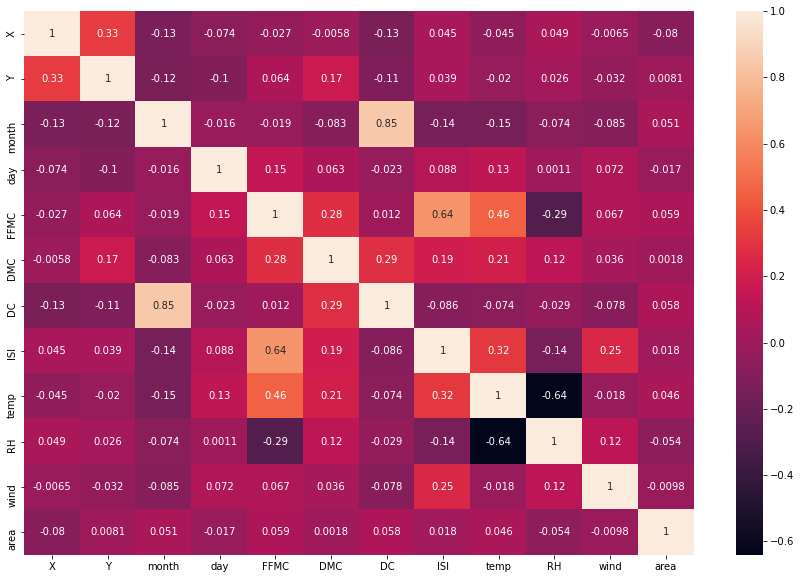

In [96]:
plt.figure(figsize = (15,10))
sns.heatmap(NOT_OUTLIER.corr(), annot = True, cbar = True)
plt.show()

In [ ]:
# This time with the dataset all being int this correlation map includes month and day this time.
# Thus finding out that Month and DC index heavily correlates together
# But now some attributes have weaker correlations together in this heatmap compared to the one leaving out month and day
# Yet I feel like it would be important to leave the month and day in as seasons can strongly suggest forest fires
# But we already know that they are more frequent in the summers, so maybe get rid of then afterall?

<AxesSubplot:xlabel='month', ylabel='area'>

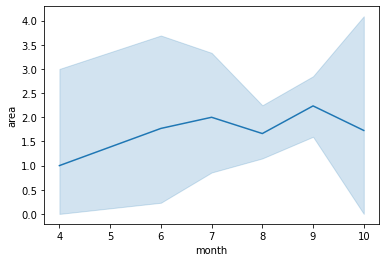

In [105]:
sns.lineplot(data = NOT_OUTLIER, x = 'month', y = 'area')

<AxesSubplot:xlabel='month', ylabel='area'>

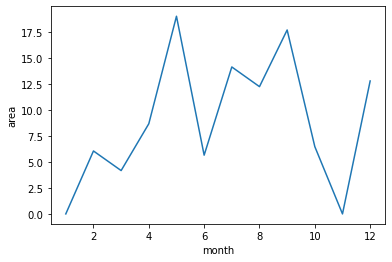

In [142]:
sns.lineplot(data = df1, x = 'month', y = 'area', ci = None)

<AxesSubplot:xlabel='month', ylabel='area'>

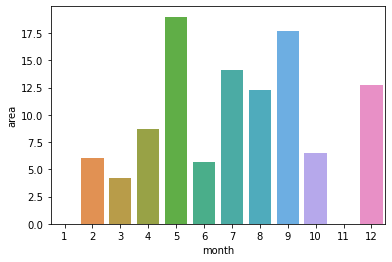

In [147]:
sns.barplot(data = df1, x ='month', y = 'area', ci = None)

<AxesSubplot:xlabel='FFMC', ylabel='area'>

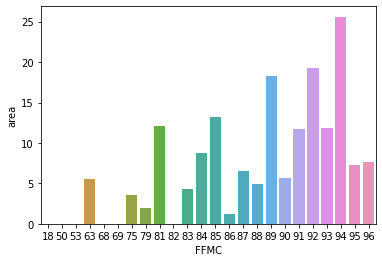

In [161]:
sns.barplot(data = df1, x ='FFMC', y = 'area', ci = None)

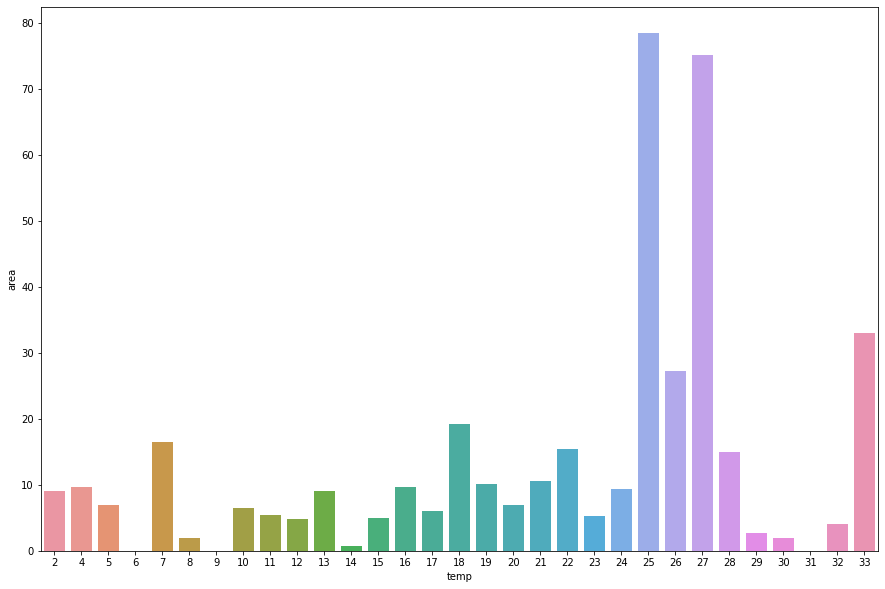

In [169]:
plt.figure(figsize = (15,10))
sns.barplot(data = df1, x = 'temp', y = 'area', ci = None)
plt.show()

<AxesSubplot:xlabel='month', ylabel='temp'>

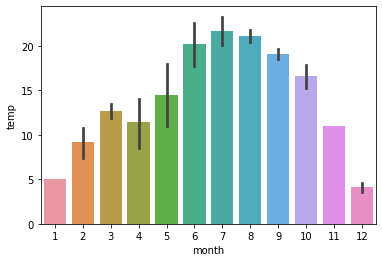

In [167]:
sns.barplot(data = df1, x = 'month', y = 'temp')

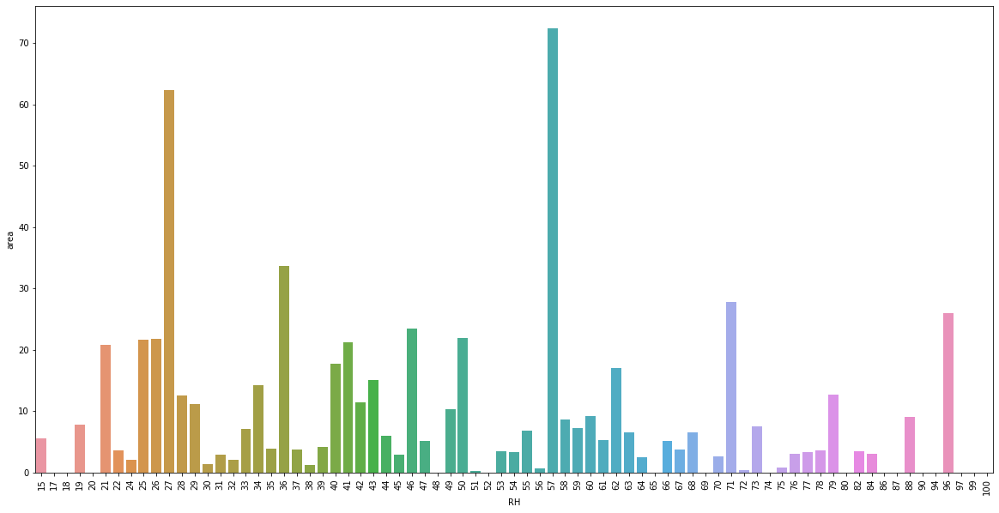

In [155]:
plt.figure(figsize = (20,10))
sns.barplot(data = df1, x = 'RH', y = 'area', ci = None)
plt.xticks(rotation = 90)
plt.show()

<AxesSubplot:xlabel='month', ylabel='RH'>

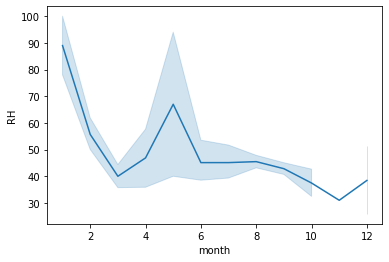

In [139]:
sns.lineplot(data = df1, x = 'month', y = 'RH')

<AxesSubplot:xlabel='month', ylabel='area'>

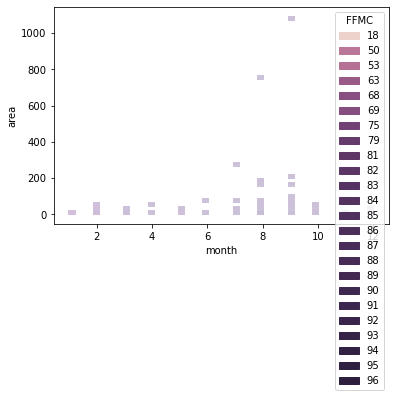

In [126]:
sns.histplot(data = df1, x = 'month', y = 'area', bins = 50, hue = 'FFMC')

In [130]:
df1.groupby('month')['area'].size()

month
1       2
2      20
3      54
4       9
5       2
6      17
7      32
8     184
9     172
10     15
11      1
12      9
Name: area, dtype: int64

<AxesSubplot:xlabel='month'>

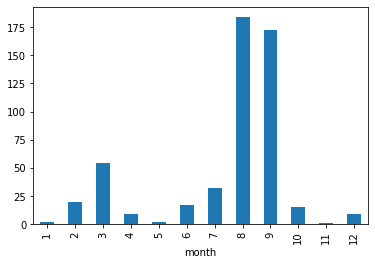

In [131]:
df1.groupby('month')['area'].size().plot(kind = 'bar')

In [ ]:
# It is apparent that during the months of august and september, that's where most of the forest is burnt during fires
# Let's see what this same graph may look like without inter quartile outliers

In [133]:
NOT_OUTLIER.groupby('month')['area'].size()

month
4       3
6      13
7      21
8     101
9     119
10     11
Name: area, dtype: int64

<AxesSubplot:xlabel='month'>

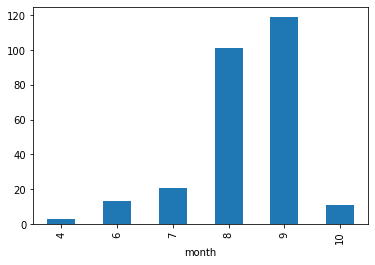

In [134]:
NOT_OUTLIER.groupby('month')['area'].size().plot(kind = 'bar')

In [ ]:
# Even when outliers are cut, august and september are still the most fequent months for forest fires

In [ ]:
# Hard to come to conclusions as to why areas can be burnt harder, lets try some machine learning

In [170]:
import pycaret.regression as pcr 

In [171]:
dir(pcr)

['Any',
 'Dict',
 'Display',
 'List',
 'MLUsecase',
 'Optional',
 'Tuple',
 'Union',
 '__builtins__',
 '__cached__',
 '__doc__',
 '__file__',
 '__loader__',
 '__name__',
 '__package__',
 '__spec__',
 'add_metric',
 'automl',
 'blend_models',
 'compare_models',
 'create_model',
 'deploy_model',
 'enable_colab',
 'ensemble_model',
 'evaluate_model',
 'finalize_model',
 'get_config',
 'get_logs',
 'get_metrics',
 'interpret_model',
 'io',
 'is_in_colab',
 'load_config',
 'load_model',
 'models',
 'np',
 'pd',
 'plot_model',
 'predict_model',
 'pull',
 'pycaret',
 'remove_metric',
 'save_config',
 'save_model',
 'set_config',
 'setup',
 'stack_models',
 'tune_model',
 'warnings']

In [172]:
pcr.setup(data = df1, target = 'area')

,Description,Value
0,session_id,8091
1,Target,area
2,Original Data,"(517, 12)"
3,Missing Values,False
4,Numeric Features,7
5,Categorical Features,4
6,Ordinal Features,False
7,High Cardinality Features,False
8,High Cardinality Method,None
9,Transformed Train Set,"(361, 41)"


('reg-default-name',
 KFold(n_splits=10, random_state=8091, shuffle=False),
 Pipeline(memory=None, steps=[('empty_step', 'passthrough')], verbose=False),
 Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=[],
                                       display_types=True, features_todrop=[],
                                       id_columns=[], ml_usecase='regression',
                                       numerical_features=[], target='area',
                                       time_features=[])),
                 ('imputer',
                  Simple_Imputer(categorical_strategy='not_available',
                                 fill_value_categorical=None,
                                 fill_value_numerical=None,
                                 numeric_strategy='m...
                 ('scaling', 'passthrough'), ('P_transform', 'passthrough'),
                 ('binn', 'passthrough'), ('rem_outliers', 'passthrough'),
       

In [173]:
pcr.compare_models()

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
huber,Huber Regressor,14.1347,5587.4388,45.8216,-0.1108,1.4219,0.7273,0.0140
llar,Lasso Least Angle Regression,21.0211,5486.3156,46.6001,-0.4344,2.1886,3.3714,0.0120
br,Bayesian Ridge,21.0440,5485.7793,46.6332,-0.4421,2.1893,3.3874,0.0120
par,Passive Aggressive Regressor,16.9376,5674.1567,47.7300,-0.5065,1.6217,1.7172,0.0140
en,Elastic Net,22.7726,5509.3489,49.1100,-1.1286,2.1906,4.0404,0.0120
omp,Orthogonal Matching Pursuit,22.5930,5653.3103,50.1394,-1.3351,2.1283,3.9258,0.0140
lasso,Lasso Regression,23.6522,5577.2302,50.3114,-1.4647,2.2112,4.0022,0.0150
ridge,Ridge Regression,26.7651,5769.8439,53.8956,-2.6194,2.3448,4.9045,0.0140
lr,Linear Regression,27.4105,5832.2136,54.6214,-2.9530,2.3766,5.0793,0.8390
lightgbm,Light Gradient Boosting Machine,26.8994,6226.0798,61.1904,-5.7697,2.2023,5.3160,0.0560


HuberRegressor(alpha=0.0001, epsilon=1.35, fit_intercept=True, max_iter=100,
               tol=1e-05, warm_start=False)

In [174]:
huber_r = pcr.create_model('huber')

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,4.4978,90.6681,9.5220,-0.0237,1.1898,0.6413
1,46.7840,35305.9658,187.8988,-0.0591,1.8157,0.7453
2,4.8948,97.7718,9.8880,-0.1384,1.2239,0.7145
3,14.2170,1218.6344,34.9089,-0.1355,1.5520,0.8251
4,9.2658,509.6945,22.5764,-0.0873,1.4358,0.7543
5,34.4888,17715.8929,133.1011,-0.0651,1.7465,0.7678
6,8.6720,365.0469,19.1062,-0.1736,1.4310,0.7682
7,6.5286,182.1127,13.4949,-0.1686,1.3676,0.6934
8,6.4777,235.4263,15.3436,-0.1299,1.2739,0.7110
9,5.5207,153.1750,12.3764,-0.1262,1.1826,0.6525


In [200]:
TH = pcr.tune_model(huber_r)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,2.9474,18.1222,4.2570,-0.2763,1.1710,1.2423
1,1.7264,5.6586,2.3788,-0.1006,0.7906,0.6108
2,2.5781,18.9492,4.3531,-0.1439,0.9357,0.6548
3,2.0096,8.5513,2.9243,-0.0472,0.8471,0.6659
4,1.1789,2.8129,1.6772,-0.2821,0.7374,0.2876
5,1.4648,6.9386,2.6341,0.0388,0.7726,0.4255
6,2.4268,15.0245,3.8761,-0.0503,0.9377,0.6103
7,2.6085,15.7889,3.9735,-0.2028,1.0008,0.7697
8,1.5096,3.0550,1.7478,-0.3162,0.8164,0.7028
9,2.6052,13.5964,3.6873,-0.2469,0.9950,0.7418


In [176]:
pcr.evaluate_model(huber_r)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

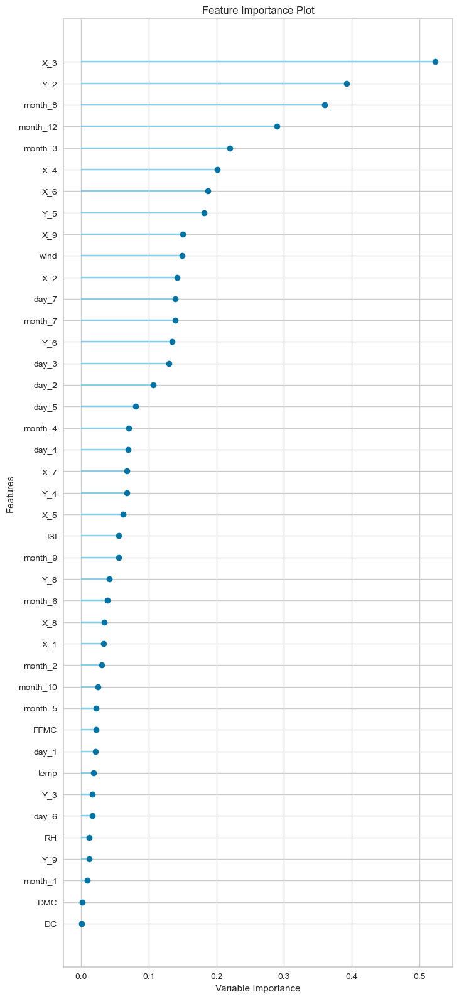

In [177]:
pcr.plot_model(huber_r, plot = 'feature_all')

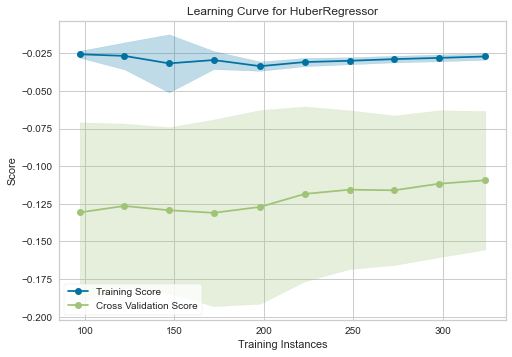

In [179]:
pcr.plot_model(huber_r, plot = 'learning')

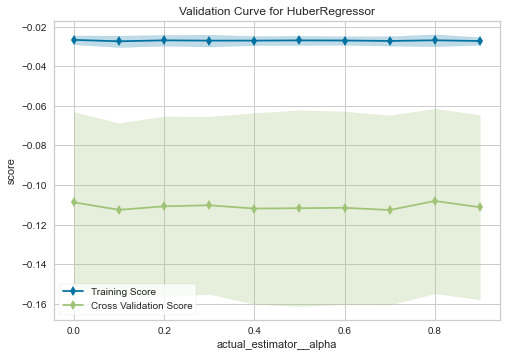

In [180]:
pcr.plot_model(huber_r, plot = 'vc')

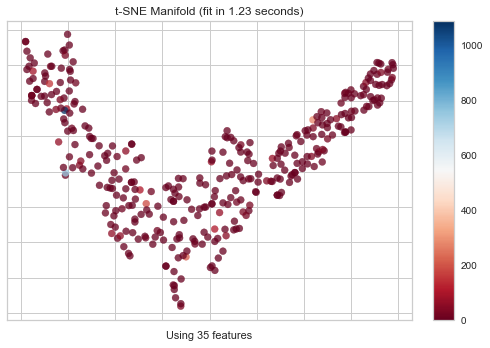

In [182]:
pcr.plot_model(huber_r, plot = 'manifold') 

In [184]:
final = pcr.finalize_model(huber_r)

In [185]:
pcr.predict_model(final)

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,Huber Regressor,9.6685,871.7204,29.5249,-0.0799,1.3613,0.7139


,FFMC,DMC,DC,ISI,temp,RH,wind,X_1,X_2,X_3,...,month_9,day_1,day_2,day_3,day_4,day_5,day_6,day_7,area,Label
0,91,142,601,10,19,41.0,5,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,196,1.964808
1,94,227,706,12,25,36.0,4,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0,1.677014
2,88,91,709,7,12,73.0,6,1.0,0.0,0.0,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,30,2.404154
3,92,88,698,7,22,40.0,4,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0,1.919805
4,91,78,724,9,19,38.0,2,0.0,0.0,0.0,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0,1.177947
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
151,85,90,609,6,17,50.0,4,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,2,1.735409
152,96,181,671,14,21,65.0,4,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0,1.616760
153,90,82,735,6,18,45.0,2,0.0,1.0,0.0,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,4,1.454866
154,95,217,690,18,28,29.0,1,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,5,0.728137


In [ ]:
# Huber Regressor with a final MAE of 9.6%, not too bad but could be better

In [ ]:
# Regressor but with no outleirs data frame

In [187]:
pcr.setup(data = NOT_OUTLIER, target = 'area')

,Description,Value
0,session_id,2803
1,Target,area
2,Original Data,"(268, 12)"
3,Missing Values,False
4,Numeric Features,7
5,Categorical Features,4
6,Ordinal Features,False
7,High Cardinality Features,False
8,High Cardinality Method,None
9,Transformed Train Set,"(187, 33)"


('reg-default-name',
 KFold(n_splits=10, random_state=2803, shuffle=False),
 Pipeline(memory=None, steps=[('empty_step', 'passthrough')], verbose=False),
 Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=[],
                                       display_types=True, features_todrop=[],
                                       id_columns=[], ml_usecase='regression',
                                       numerical_features=[], target='area',
                                       time_features=[])),
                 ('imputer',
                  Simple_Imputer(categorical_strategy='not_available',
                                 fill_value_categorical=None,
                                 fill_value_numerical=None,
                                 numeric_strategy='m...
                 ('scaling', 'passthrough'), ('P_transform', 'passthrough'),
                 ('binn', 'passthrough'), ('rem_outliers', 'passthrough'),
       

In [189]:
pcr.compare_models()

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
br,Bayesian Ridge,2.2907,9.9464,3.0442,-0.1169,0.9393,0.6215,0.0080
llar,Lasso Least Angle Regression,2.2925,9.9386,3.0458,-0.1219,0.9394,0.6179,0.0080
lasso,Lasso Regression,2.2997,10.1060,3.0647,-0.1274,0.9459,0.6247,0.0070
en,Elastic Net,2.3107,10.1795,3.0759,-0.1357,0.9509,0.6265,0.0080
huber,Huber Regressor,1.8989,11.6826,3.2637,-0.2355,0.8833,0.7848,0.0130
omp,Orthogonal Matching Pursuit,2.4065,11.0492,3.2204,-0.2696,0.9929,0.6774,0.0090
par,Passive Aggressive Regressor,2.0150,12.1490,3.3365,-0.3022,0.9451,0.8585,0.0080
knn,K Neighbors Regressor,2.5968,12.5300,3.4212,-0.4477,1.0832,0.8185,0.0100
ridge,Ridge Regression,2.4988,12.5136,3.4236,-0.4672,1.0323,0.8281,0.0080
rf,Random Forest Regressor,2.5560,12.3063,3.4218,-0.4824,1.0418,0.7940,0.0670


BayesianRidge(alpha_1=1e-06, alpha_2=1e-06, alpha_init=None,
              compute_score=False, copy_X=True, fit_intercept=True,
              lambda_1=1e-06, lambda_2=1e-06, lambda_init=None, n_iter=300,
              normalize=False, tol=0.001, verbose=False)

In [190]:
br_r = pcr.create_model('br')

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,2.7888,14.5883,3.8195,-0.0274,1.0461,0.8079
1,1.8557,5.0546,2.2482,0.0169,0.8168,0.5432
2,2.6927,17.4026,4.1716,-0.0506,0.9517,0.5687
3,2.1423,8.2390,2.8704,-0.0089,0.8851,0.6233
4,1.6525,3.3518,1.8308,-0.5278,0.8925,0.6260
5,2.1297,8.2681,2.8754,-0.1453,1.0213,0.5714
6,2.6911,14.4211,3.7975,-0.0081,0.9861,0.7205
7,2.7562,13.7004,3.7014,-0.0437,0.9875,0.6265
8,1.6611,3.0950,1.7592,-0.3335,0.8746,0.5608
9,2.5374,11.3431,3.3679,-0.0402,0.9317,0.5667


In [191]:
Tuned_br = pcr.tune_model(br_r)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,2.8019,14.9357,3.8647,-0.0518,1.0573,0.8372
1,1.8180,4.9001,2.2136,0.0469,0.8079,0.5180
2,2.7005,17.6642,4.2029,-0.0663,0.9632,0.5543
3,2.1963,8.4949,2.9146,-0.0403,0.9221,0.6129
4,1.6205,3.3167,1.8212,-0.5118,0.8754,0.6706
5,2.1405,8.3473,2.8892,-0.1563,1.0258,0.5533
6,2.6779,14.3762,3.7916,-0.0050,0.9792,0.7433
7,2.7896,14.2434,3.7740,-0.0851,1.0063,0.6430
8,1.6237,3.0074,1.7342,-0.2957,0.8561,0.5668
9,2.4677,11.2820,3.3589,-0.0346,0.9120,0.5564


In [192]:
pcr.evaluate_model(br_r)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

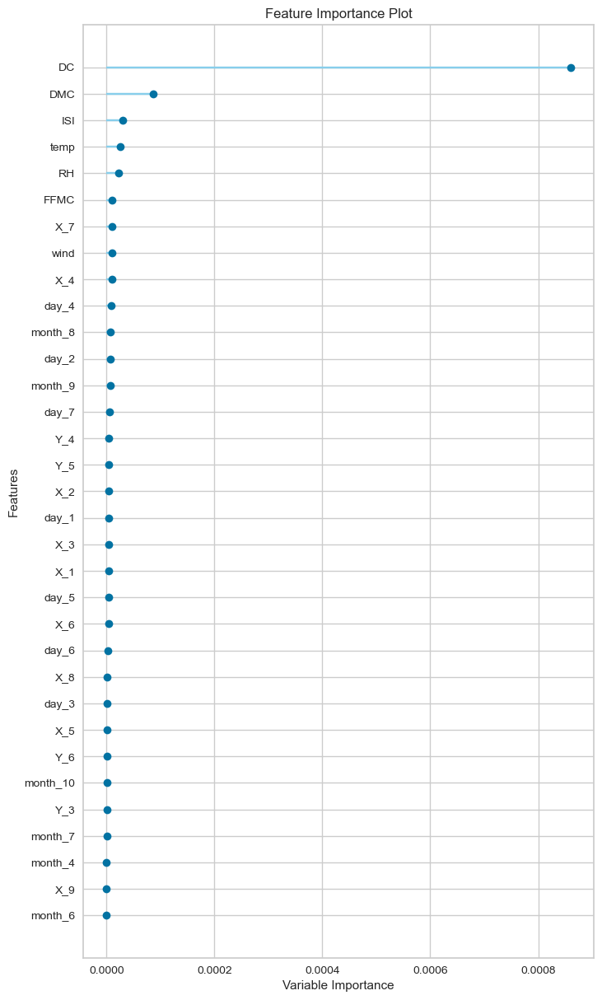

In [193]:
pcr.plot_model(br_r, plot = 'feature_all')

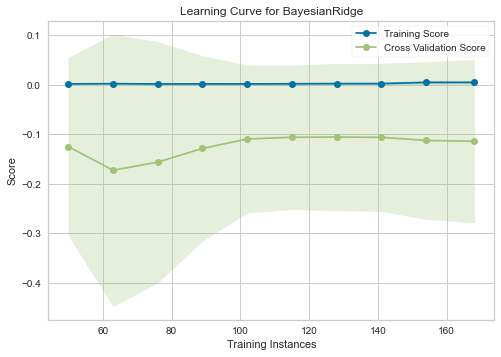

In [194]:
pcr.plot_model(br_r, plot = 'learning')

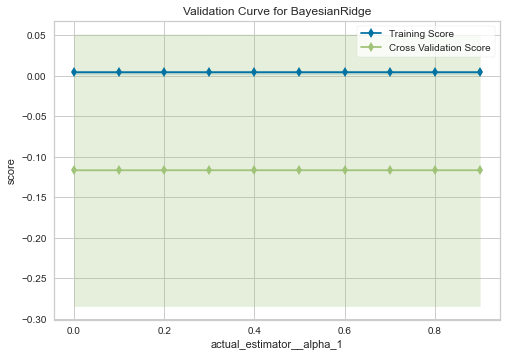

In [195]:
pcr.plot_model(br_r, plot = 'vc')

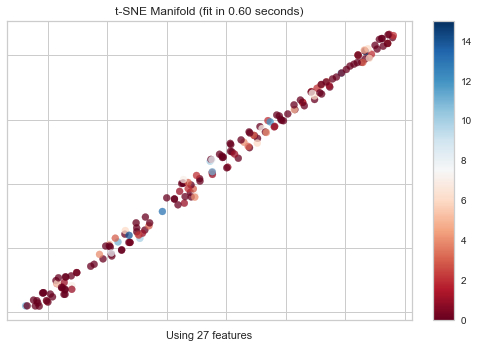

In [196]:
pcr.plot_model(br_r, plot = 'manifold')

In [197]:
final1 = pcr.finalize_model(br_r)

In [198]:
pcr.predict_model(final1)

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,Bayesian Ridge,2.6399,13.5967,3.6874,-0.0178,0.9530,0.5963


,FFMC,DMC,DC,ISI,temp,RH,wind,X_1,X_2,X_3,...,month_9,day_1,day_2,day_3,day_4,day_5,day_6,day_7,area,Label
0,93,141,713,13,22,44.0,5,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0,2.001951
1,92,105,758,9,24,28.0,1,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,14,2.048012
2,90,126,686,7,14,70.0,3,0.0,0.0,0.0,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0,1.973894
3,92,152,658,14,19,53.0,2,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,4,1.950849
4,94,130,587,14,23,40.0,5,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1,1.893863
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
76,90,99,631,6,21,34.0,2,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0,1.936190
77,93,235,723,10,24,50.0,4,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0,2.000400
78,93,75,466,7,19,36.0,3,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0,1.793984
79,91,175,700,13,22,54.0,7,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2,1.985200


In [ ]:
# Final R2 score of -0.0178 nice seem DC is the most important attribute for predicting and somewhat DMC for regression

In [ ]:
# It seems that getting rid of outliers and dropping rain was a good idea afterall, From huber regressor we learned that it
# will predict burnt areas take place at certain parts at certain times
# Bayesian ridge tells us that DC and some DMC is something to consider the amount of forest fires burnt